In [1]:
#matplotlib inline
%matplotlib widget

In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from math import floor, ceil

import re # For regular expressions
from pprint import pprint # pretty printing of dicts

from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, max_error, accuracy_score
from sklearn.decomposition import TruncatedSVD

from scipy.interpolate import RBFInterpolator

from pydmd import DMD
import pysindy as ps

In [3]:
path = '../Experimental data/Heat conduction processed/' # Define experimental data path
files = []
experiments = {}
for dirname, _, filenames in os.walk(path):
    for filename in filenames:
        if re.search("csv$", filename):  # Search if filename ends in 'csv'
            experiments.update({filename.split('.')[0]:[(os.path.join(dirname,filename))]})

#pprint(experiments)

In [4]:
# Remove any unwanted files - eg .ipynb_checkpoints
experiments_dummy = experiments.copy() # Create dummy variable so dict does not change while iterating
for name, values,  in experiments.items():
    path = values[0]
    if re.search("ipynb_checkpoints", path):
        del(experiments_dummy[name])
experiments = experiments_dummy

In [5]:
#pprint(experiments)

In [6]:
# Create sensible variable names for the files
from operator import itemgetter
experiments_new = {}
for name, values in experiments.items():
    path = values[0]
    names = name.split()
    title = list(itemgetter(1,3,-2,-1)(names))
    title = str(" ".join(title)).capitalize()
    values.append(title)
    if names[-2] == 'single':
        names[4] = 'ss'
    elif names[-2] == 'double':
        names[4] = 'ds'
    names = list(itemgetter(1,4,3)(names))
    var_name = str("_".join(names))
    experiments_new[var_name] = tuple(values)

experiments = experiments_new

In [7]:
pprint(experiments)

{'aluminium_ss_dry': ('../Experimental data/Heat conduction processed/Narrow '
                      'aluminium 2kg dry single side.csv',
                      'Aluminium dry single side'),
 'aluminium_ss_oil': ('../Experimental data/Heat conduction processed/Narrow '
                      'aluminium 2kg oil single side.csv',
                      'Aluminium oil single side'),
 'steel_ds_silicone': ('../Experimental data/Heat conduction processed/Narrow '
                       'steel 2kg silicone htc double side.csv',
                       'Steel silicone double side'),
 'steel_ss_dry': ('../Experimental data/Heat conduction processed/Narrow steel '
                  '2kg dry single side.csv',
                  'Steel dry single side'),
 'steel_ss_oil': ('../Experimental data/Heat conduction processed/Narrow steel '
                  '2kg oil single side.csv',
                  'Steel oil single side'),
 'steel_ss_silicone': ('../Experimental data/Heat conduction processed/Narrow '
 

In [8]:
# Define Experiment class with all methods for the experiments.

from weakref import WeakSet

class Experiment(object):
    """
    Create an instance of the class "Experiment".
    """
    
    instances = WeakSet()
    
    def __init__(self, *, title, timestep=5, plot=True, save_fig=False, **kwargs):
        """
        Docstring:
        Takes the path of the input file is csv format,
        stores it in a dataframe with columns for each timestep
        and rows for each pixel.
        
        Parameters:
        -----------
        *argv:
            title: the title used for plots
            timestep: the time interval between each data snapshot
            plot: plot a surface plot of the raw data. default=True
            save_fig: save the plot of the raw data in .png format. default=False
        
        Other parameters:
        -----------------
        **kwargs:
            file: path to csv file of data
            data: raw python data to be converted into pandas dataframe
        
        Returns:
        --------
        Plots a surface plot of the input data
        
        """
        if "file" in kwargs:
            self.file = kwargs.get("file")
            self.data = pd.read_csv(self.file)
        elif "data" in kwargs:
            self.data = pd.DataFrame(kwargs.get("data"))
        else:
            raise Exception("Input data or file required instantiate Experiment class")
            
        self.timestep = timestep
        self.data.columns.name = 'time [$s$]'
        self.data.columns = self.data.columns.astype(int)*timestep
        self.data.index.name = 'pixel'
        self.title = title
        
        print(f"Adding instance: '{self.title}'.")
        Experiment.instances.add(self)
        
        if ((plot==True) or (save_fig==True)):
            fig = plt.figure()
            ax = fig.add_subplot(111, projection="3d", title=f"Surface plot of {title.lower()}'s data",
                                 xlabel="Pixel #", ylabel="Time [s]", zlabel="Temperature [C]")
            X, Y = np.meshgrid(self.data.index, self.data.columns)
            surf = ax.plot_surface(X, Y, self.data.to_numpy().T, cmap="viridis")
            fig.colorbar(surf, label="Temperature [C]")
            
            if (plot==True):
                plt.show()
        
        if (save_fig == True):
            fname =f"{self.title} surface plot.png"
            fig.get_figure().savefig(fname)
    
    def set_meta_params(self, *, set_global=True, plot_2d=False, plot_3d=False, **kwargs):
        """
        Docstring:
        Set parameters to reduce the amount of data in the dataframe.
        Note that all arguments should be passed at once, else the default values will be used
        
        Parameters:
        ----------
        *argv:
            set_global = set meta parameters for instance using new parameters.
            plot_2d: option to show where meta paramaters cut plot in 2d. default=False
            plot_3d: option to show where meta paramaters cut plot in 2d. default=False
        **kwargs:
            start_pix: starting pixel. defualt=70
            end_pix: ending pixel. defualt=500
            pix_spacing: spacing between pixels. defualt=50
            start_t: first timestep to include in dataset. defualt=0
            end_t: last timestep to include in dataset. defualt=data.columns[-1]
            t_interval: spacing between desired samples of time defualt = 500s
        
        Returns
        -------
        None
        """
        
        self.meta = {
            "start_pix": kwargs.get("start_pix", 70),
            "end_pix": kwargs.get("end_pix", 500),
            "pix_spacing": kwargs.get("pix_spacing", 50),
            "start_t": kwargs.get("start_t", 0),
            "end_t": kwargs.get("end_t", self.data.columns[-1]),
            "t_interval": kwargs.get("t_interval", 5)
            }
        
        print(self.meta)

        if self.meta["t_interval"]%self.timestep !=0:
            raise Exception("t_interval needs to be divisible by the timestep")
        
        if plot_2d==True:
            self.data.plot()
            plt.title(f"Plot of {self.title.lower()}'s data at {self.meta['t_interval']}s intervals")
            plt.grid()
            plt.ylabel("Temperature [$\deg C$]")
            plt.xlabel("pixel")
            plt.axvline(self.meta["start_pix"], c='k', linestyle='--')
            plt.axvline(self.meta["end_pix"], c='k', linestyle='--')
            plt.legend().remove()
            plt.show()
        
        if plot_3d==True:
            pass # Causes kernel to crash for some reason, so pass
            fig = plt.figure()
            ax = fig.add_subplot(111, projection="3d", title=f"Surface plot of {title.lower()}'s data", xlabel="Pixel #",
                                 ylabel="Time [s]", zlabel="Temperature [C]")
            X, Y = np.meshgrid(self.data.index, self.data.columns)
            ax.plot_surface(X, Y, self.data.to_numpy().T, cmap="viridis")
            ys = np.arange(0, self.data.columns.max(), self.meta["t_interval"])
            zs = np.linspace(0, self.data.max(), np.shape(ys)[0])
            yy, zz = np.meshgrid(ys, zs)
            xx1 = self.meta["start_pix"]
            xx2 = self.meta["end_pix"]
            ax.plot_surface(xx1, yy, zz)
            ax.plot_surface(xx2, yy, zz)
            plt.show()
        
        if (set_global==True):
            self.reduced_data = self.reduce_data(**self.meta)
    
    def reduce_data(self, **kwargs):
        """
        Docstring:
        Reduce a full dataframe with time as columns and pixels as rows
        to a smaller dataframe according to the paramaters inherited from 
        'meta' or parameters set with **kwargs.
        
        Parameters:
        ----------
        **kwargs:
            start_pix: starting pixel.
            end_pix: ending pixel.
            pix_spacing: spacing between pixels.
            start_t: first timestep to include in dataset.
            end_t: last timestep to include in dataset.
            t_interval: spacing between desired samples of time.
            
        Returns:
        --------
        the data from the full set reduced according to the specified parameters
        """
        _meta = self.meta.copy()
        
        for arg in kwargs:
            _meta.update({arg:kwargs.get(arg)})
            
        if _meta["t_interval"]%self.timestep !=0:
            raise Exception("t_interval needs to be divisible by the timestep")
        
        print(f"Using meta parameters {_meta}")
        reduced_data = self.data.loc[_meta["start_pix"]:_meta["end_pix"]:_meta["pix_spacing"],
                                     range(_meta["start_t"], _meta["end_t"]+1, _meta["t_interval"])]
        return(reduced_data)
    
    def time_seriesCV(self, *, data, n_splits=5):
        """
        Docstring:
        Perform splitting of time series data into train and test samples.
        See 'sklearn.model_selection.TimesSeriesSplit' for more information.
        
        Parameters:
        ----------
        n_splits: number of splits. default = 5
        data: data to split into training and test sets. if 'None', uses self.reduced_data
        
        Returns:
        --------
        X_train, X_test, y_train, y_test
        """
        if (data==None):
            print("Using self.reduced_data")
            data = self.reduced_data
        
        X = data
        
        tscv = TimeSeriesSplit()
        for train_index, test_index in tscv.split(X):
            print("TRAIN:", train_index, "TEST:", test_index)
            X_train, X_test = X[train_index], X[test_index]
            y_train, y_test = y[train_index], y[test_index]

        self.X_train = X_train
        self.X_test = X_test
        self.y_train = y_train
        self.y_test = y_test
        
        return(X_train, X_test, y_train, y_test)
    
    def temp_profile(self, *, plot_2d=True, plot_3d=True, waterfall_pix_spacing=50, save_fig=False, **kwargs):
        """
        Docstring:
        Plot reduced temperature profile of reduced dataframe at discrete times
        If pix_spacing and t_interval are not passed as arguments, they default to 1 pix and 500s respectively
    
        Parameters:
        ----------
        *argv:
            plot_2d: the temperature profile at set paramaters of reduced data. default=True
            save_fig: save the plot of the raw data in .png format. default=False
            waterfall_pix_spacing: plot every x pixels in the waterfall plot. default = 50
        **kwargs:
            start_pix: starting pixel.
            end_pix: ending pixel.
            pix_spacing: spacing between pixels.
            start_t: first timestep to include in dataset.
            end_t: last timestep to include in dataset.
            t_interval: spacing between desired samples of time.
            
        Returns:
        --------
        None
        """
        _meta = self.meta.copy()
        _meta.update({"pix_spacing": 1})
        _meta.update({"t_interval": 500})
        
        for arg in kwargs:
            _meta.update({arg:kwargs.get(arg)})
            
        _reduced = self.reduce_data(**_meta)
        
        if ((plot_2d==True) or (save_fig==True)):
            plot = _reduced.plot(title=f"{self.title} temperature profile", ylabel='Temperature [$\degree C$]', grid=True)
            if kwargs.get("save_fig") == True:
                fname =f"{self.title} temperature profile.png"
                plot.get_figure().savefig(fname)
            plt.show()
        
        if (plot_3d==True):
            # Waterfall plot
            T = _reduced.iloc[:][0:-1:waterfall_pix_spacing]
            t = T.columns.to_numpy()
        
            fig = plt.figure()
            ax = fig.add_subplot(111, projection='3d')
            plt.set_cmap('jet')
            ax.set_xlabel("Time")
            ax.set_zlabel("Temperature")
            #ax.set_ylabel("")
            T_plot = T.to_numpy()
            for j in range(T_plot.shape[0]):
                ys = j*np.ones(T_plot.shape[1])
                ax.plot(t, ys, T_plot[j,:])
            plt.show()

    def temp_gradient(self):
        dtdx = np.gradient(self.data.to_numpy(), axis=0)
        dTdt = np.gradient(self.data.to_numpy(), axis=1)
        return dtdx, dTdt
        
    def plot_pcolor(self):
        """
        Docstring
        Plot psuedocolor plot for reduced data set
        
        Returns:
        --------
        None
        """
        fig, (ax1) = plt.subplots(1,1) #, figsize=(35,10))
        plt.set_cmap('jet')
        ax1.set_title('Original')
        a1 = ax1.pcolormesh(self.reduced_data)
        ax1.set_ylabel('pixel #')
        ax1.set_xlabel('snapshot #')
        plt.colorbar(a1, ax=ax1, label='Temperature [$\degree C$]')
        
    def SVD(self, n):
        """
        Docstring
        Perform a singular value decomposition on self.reduced_data
    
        Parameters:
        ----------
        n = number of terms to keep for truncated SVD. If set to 0, full SVD is used
        
        Returns:
        --------
        (X, (U, S, VT))
        """
        X = self.reduced_data.to_numpy()
        U, S, VT = np.linalg.svd(X,full_matrices=False)
        S = np.diag(S)
        if (n==0):     
            return (X, (U, S, VT))
        elif(n!=0):
            U_trunc = U[:,:n]
            S_trunc = S[0:n,:n]
            VT_trunc = VT[:n,:]
            X_trunc = U_trunc @ S_trunc @ VT_trunc # U[:,:n] @ S[0:n,:n] @ VT[:n,:]
            return (X_trunc, (U_trunc, S_trunc, VT_trunc))
        
    def SVD_opt_hard_threshold(self, cutoff, n):
        """
        Docstring
        Uses the singular value decomposition, and uses the optimal hard treshold
        to cutoff the data.
    
        Parameters:
        ----------
        cutoff: the threshold to cutoff the data in the SVD
        n: the number of terms in the economy/truncated SVD if it is to be used.
        
        Returns:
        --------
        (X, (U, S, VT))
        """
        
        def cuttoff_approx(beta):
            def lam(beta):
                return np.sqrt(2*(beta+1) + (8*beta)/((beta+1) + np.sqrt(beta**2 + 14*beta +1)))
            tau = lam(beta) * np.sqrt(n) * gamma
            return tau
        
        X, (U, S, VT) = self.SVD(n)
        
        beta = X.shape[0]/X.shape[1]
        print(f"Beta = {beta}")
        
        if (cutoff==None):
            print("No cutoff threshold provided. Using approximation")
            cutoff = cutoff_approx(beta)
            print(f"Cutoff = {cutoff}")
        
        print(f"X.shape = {X.shape}")
        
        r = np.max(np.where(S>cutoff))
        print(f"r = {r}")
        
        Xclean = U[:,:(r+1)] @ np.diag(S[:(r+1)]) @ VT[:(r+1),:]
        print(f"Xclean.shape = {Xclean.shape}")
        return Xclean
        
    def SVD_scan(self, n_singular_values=(0,1,2,5,10,50,100), save_fig=False, **kwargs):
        """
        Docstring:
        Scan through a range of SVD singular values
    
        Parameters:
        ----------
        n: list of singular values to check and plot results for
        *argv:
            save_fig: save the plot of the raw data in 
        """
        n_cols = 2
        n_metrics = 2
        n_plots = ((len(n_singular_values))*2) + n_metrics
        n_rows = ceil((n_plots)/n_cols)
        
        subplot_str = str(n_rows)+str(n_cols)+str(1)
        subplot_num = int(subplot_str)
        
        X, (U, S, VT) = self.SVD(n=0)   # Get the full SV
        
        fig = plt.figure(figsize=(7*n_cols, 15*n_cols), constrained_layout=True)#, tight_layout=True) 
                         
        plt.suptitle(f"SVD sweep for {self.title.lower()}")
        
        ax = plt.subplot2grid((n_rows,n_cols), (0,0))
        ax.semilogy(range(S.shape[0]), np.diag(S))
        ax.set_xlabel("SVD term")
        ax.set_ylabel("Term energy")
        for i in n_singular_values:
            ax.scatter(i, np.diag(S)[i], c='r')
            ax.text(i+0.5, np.diag(S)[i], f"{i}")
        ax.set_title("Singular value energy")
        

        ax = plt.subplot2grid((n_rows,n_cols), (0,1))        
        ax.plot(range(S.shape[0]), 100*np.cumsum(np.diag(S))/np.sum(np.diag(S)))
        ax.set_xlabel("SVD term")
        ax.set_ylabel("Percentage of total energy captured")
        for i in n_singular_values:
            ax.scatter(i, 100*np.cumsum(np.diag(S))[i]/np.diag(S).sum(), c='r')
            ax.text(i+0.5, 100*np.cumsum(np.diag(S))[i]/np.diag(S).sum(), f"{i}")
        ax.set_title(f"Cumulative energy captured")
        
        
        offset=1
        for i in range(offset, offset + len(n_singular_values)):
            for j in range(n_cols):
                n = n_singular_values[i-offset]
                if (j==0):
                    ax = plt.subplot2grid((n_rows,n_cols), (i,j))
                    if (n==0):
                        ax.set_title(f"Original reduced dataset")
                    elif(n!=0):
                        ax.set_title(f"Data revovered for {n} SVD terms")
                    a0 = ax.pcolormesh(self.SVD(n=n)[0], cmap='jet')
                    plt.colorbar(a0, ax=ax, label='Temperature [$\degree C$]')
                if (j==1):
                    ax = plt.subplot2grid((n_rows,n_cols), (i,j))
                    if (n==0):
                        ax.set_title(f"n = 0, Please ignore this subplot")
                    elif(n!=0):
                        ax.set_title(f"Error beween original data and reduction with {n} SVD terms")
                    a1 = ax.pcolormesh(self.SVD(n=0)[0]-self.SVD(n=n)[0], cmap='jet')
                    plt.colorbar(a1, ax=ax, label='Temperature error [$\degree C$]')
        if (save_fig==True):
            fig.savefig(f"{self.title} SVD scan.png")
            
    def polyreg(self, x, y, deg):
        reg = np.polynomial.Polynomial.fit(x, y, deg)
        plt.title(f"Polynomial of degree {deg}")
        plt.plot(x, y, label="Original data")
        plt.plot(x, reg(x), label="Regression model")
        plt.legend()
        plt.show()
        print(f"Regression formula = {reg}")
    
    def PCA(self, *n_singular_values):
        scaler = StandardScaler()
        if not n_singular_values:
            n_singular_values = (1,2,5,10,50,100) # Default singular values if none are given
        _X = self.data.to_numpy()
        X = scaler.fit_transform(_X)
        return(X)
    
    def DMD(self):
        pass
    
    @classmethod
    def get_instances(cls):
        return list(Experiment.instances) #Returns list of all current instances


In [9]:
for var_name, (file,title) in experiments.items():
    exec(f"{var_name} = Experiment(title='{title}', file='{file}', plot=False, save_fig=False)")

Adding instance: 'Steel dry single side'.
Adding instance: 'Steel silicone single side'.
Adding instance: 'Steel silicone double side'.
Adding instance: 'Aluminium oil single side'.
Adding instance: 'Steel oil single side'.
Adding instance: 'Aluminium dry single side'.


In [10]:
steel_ss_dry.set_meta_params(start_pix=95, end_pix=495, pix_spacing=1, plot_2d=False, plot_3d=False)
steel_ss_silicone.set_meta_params(start_pix=80, end_pix=480, pix_spacing=1)
steel_ss_oil.set_meta_params(start_pix=95, end_pix=495, pix_spacing=1)
steel_ds_silicone.set_meta_params(start_pix=65, end_pix=465, pix_spacing=1)
aluminium_ss_dry.set_meta_params(start_pix=75, end_pix=475, pix_spacing=1)
aluminium_ss_oil.set_meta_params(start_pix=80, end_pix=480, pix_spacing=1)

{'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2435, 't_interval': 5}
Using meta parameters {'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2435, 't_interval': 5}
{'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
{'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2420, 't_interval': 5}
Using meta parameters {'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2420, 't_interval': 5}
{'start_pix': 65, 'end_pix': 465, 'pix_spacing': 1, 'start_t': 0, 'end_t': 1270, 't_interval': 5}
Using meta parameters {'start_pix': 65, 'end_pix': 465, 'pix_spacing': 1, 'start_t': 0, 'end_t': 1270, 't_interval': 5}
{'start_pix': 75, 'end_pix': 475, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2395, 't_interval': 5}
Using meta parameters {'start_

In [11]:
for instance in Experiment.get_instances():
    instance.temp_profile(plot_2d=False, plot_3d=False)

Using meta parameters {'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2435, 't_interval': 500}
Using meta parameters {'start_pix': 95, 'end_pix': 495, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2420, 't_interval': 500}
Using meta parameters {'start_pix': 75, 'end_pix': 475, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2395, 't_interval': 500}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 500}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2800, 't_interval': 500}
Using meta parameters {'start_pix': 65, 'end_pix': 465, 'pix_spacing': 1, 'start_t': 0, 'end_t': 1270, 't_interval': 500}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
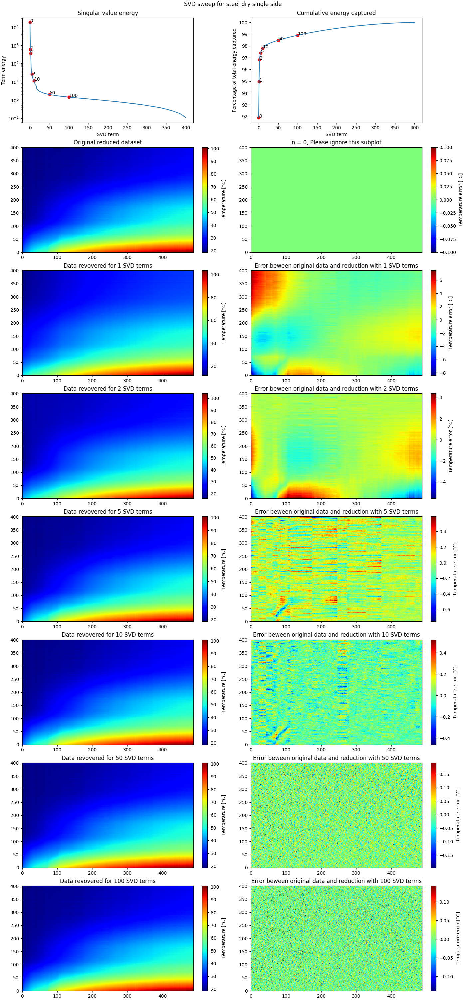

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
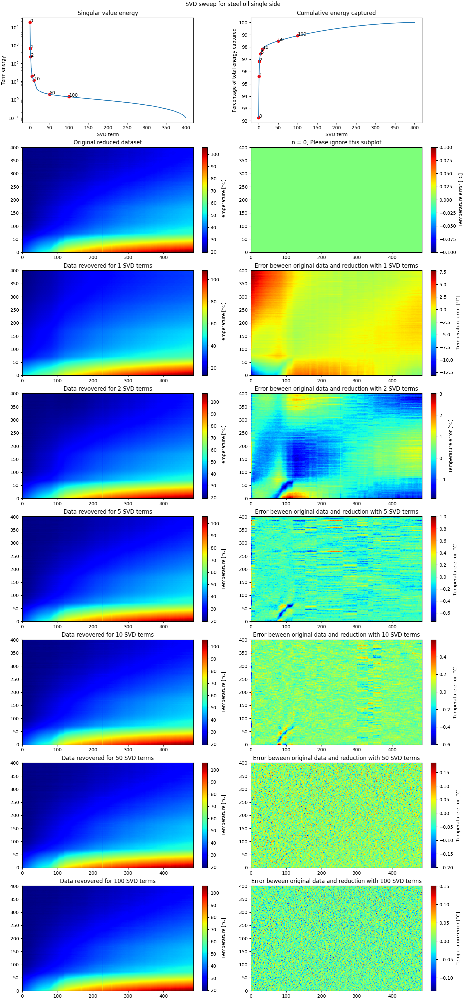

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
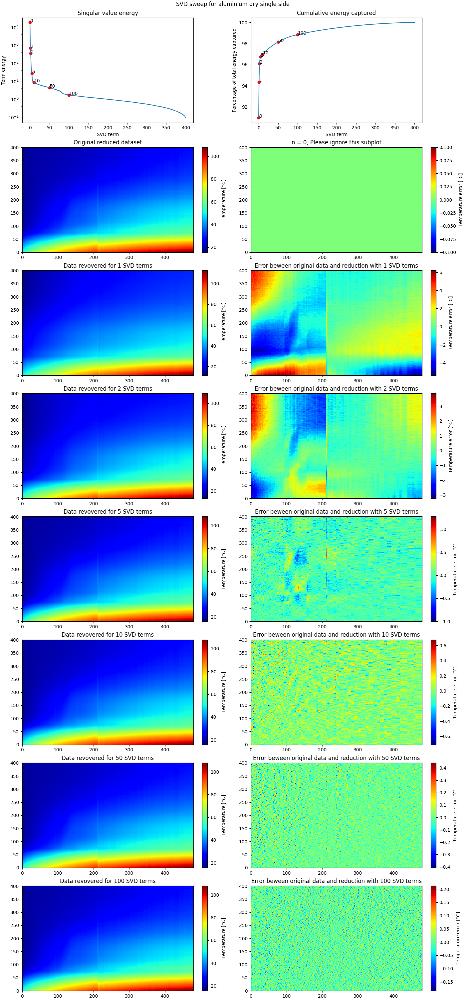

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
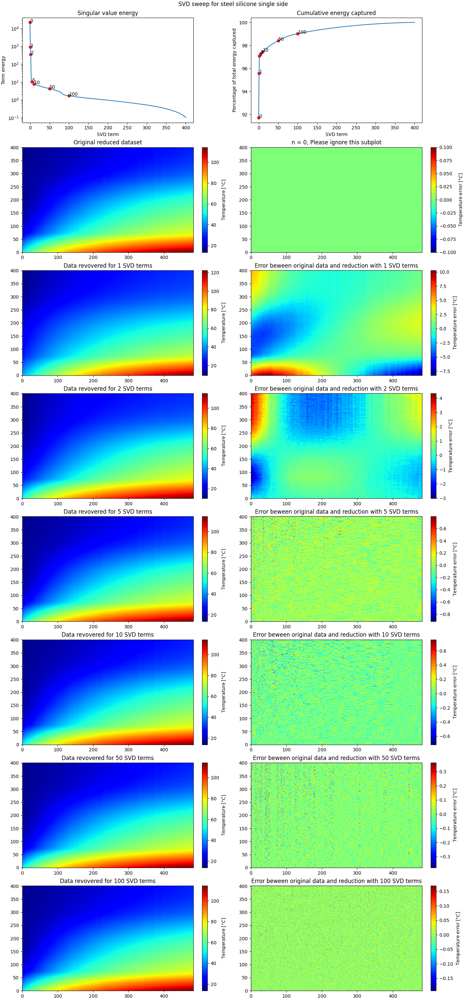

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
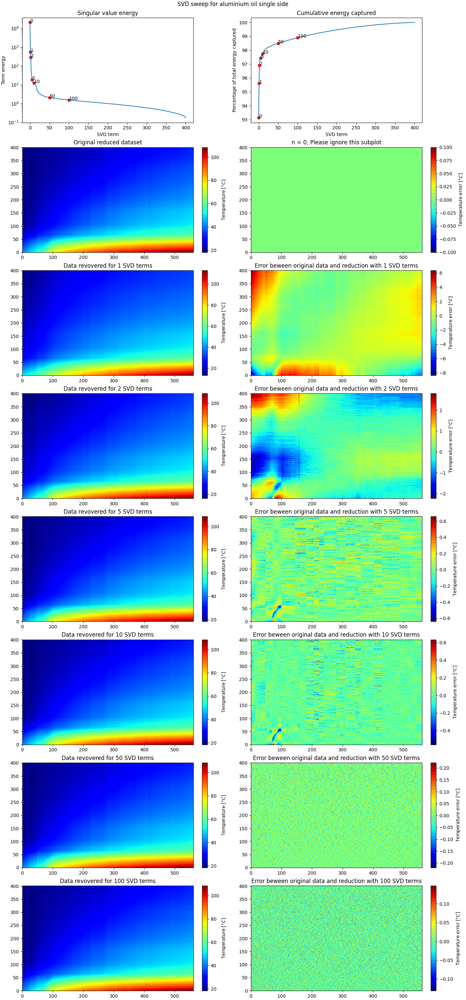

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
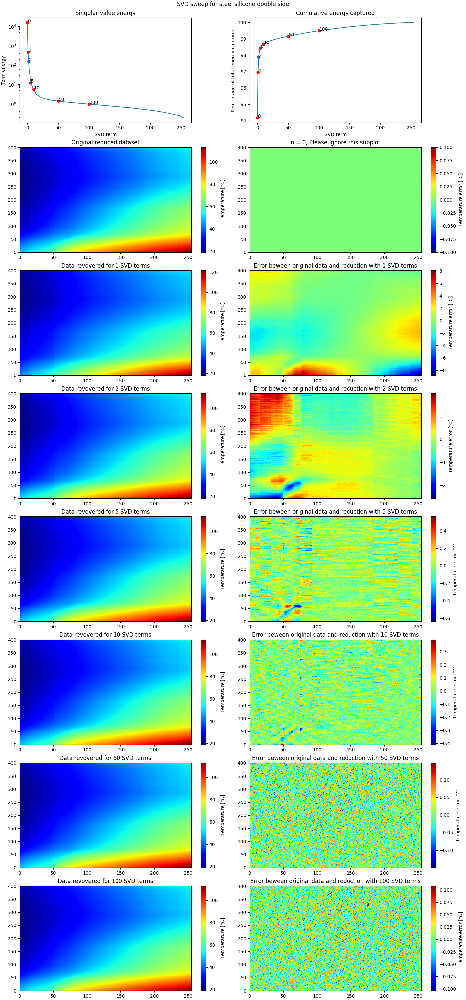

In [12]:
for instance in Experiment.get_instances():
    instance.SVD_scan()

# Experimental area

## PySINDY
### Single pixel over time

In [13]:
x = steel_ss_dry.data.transpose()

In [16]:
x

pixel,0,1,2,3,4,5,6,7,8,9,...,577,578,579,580,581,582,583,584,585,586
time [$s$],,,,,,,,,,,,,,,,,,,,,
0,29.5,29.2,29.4,29.6,30.1,30.1,30.2,30.5,30.4,30.9,...,20.2,20.3,20.5,20.2,20.7,20.2,20.4,20.4,20.3,20.5
5,29.8,29.7,29.9,30.2,30.5,30.6,30.7,31.0,30.9,31.4,...,20.2,20.1,20.5,20.1,20.7,20.2,20.4,20.4,20.2,20.5
10,30.1,30.0,30.1,30.5,30.8,31.0,31.2,31.4,31.4,31.7,...,20.3,20.2,20.5,20.2,20.6,20.2,20.4,20.4,20.3,20.4
15,30.5,30.4,30.5,30.8,31.2,31.4,31.5,31.7,31.7,32.1,...,20.3,20.1,20.4,20.1,20.7,20.2,20.4,20.5,20.3,20.5
20,30.8,30.7,30.7,31.1,31.5,31.6,31.7,32.1,32.0,32.4,...,20.2,20.1,20.5,20.1,20.7,20.2,20.4,20.5,20.2,20.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2415,76.3,77.3,78.2,79.0,80.4,81.2,81.6,82.6,83.2,84.3,...,31.5,31.1,31.2,31.2,31.2,31.0,30.8,31.4,30.6,30.7
2420,76.4,77.3,78.3,79.1,80.5,81.3,81.7,82.7,83.3,84.4,...,31.5,31.1,31.2,31.2,31.2,30.9,30.8,31.2,30.6,30.7
2425,76.4,77.4,78.3,79.1,80.5,81.3,81.7,82.8,83.4,84.4,...,31.5,31.1,31.2,31.2,31.2,30.9,30.9,31.3,30.7,30.7


In [17]:
X = x.loc[:][250]

In [18]:
X

time [$s$]
0       19.7
5       19.7
10      19.8
15      19.8
20      19.8
        ... 
2415    49.8
2420    49.8
2425    49.8
2430    49.9
2435    49.8
Name: 250, Length: 488, dtype: float64

In [19]:
time = X.index.to_numpy()

In [20]:
Temp = X.to_numpy()

In [21]:
model = ps.SINDy(feature_names=["T"])
model.fit(Temp, t=time)

/home/patrick/.python-virtual-enivronments/mrn/lib/python3.9/site-packages/pysindy/optimizers/stlsq.py:163: UserWarning: Sparsity parameter is too big (0.1) and eliminated all coefficients
  warnings.warn(


SINDy(differentiation_method=FiniteDifference(),
      feature_library=PolynomialLibrary(), feature_names=['T'],
      optimizer=STLSQ())

In [22]:
model.print()

T' = 0.000


In [23]:
def OVHT(beta):
    def lam(beta):
        return np.sqrt(2*(beta+1) + (8*beta)/((beta+1) + np.sqrt(beta**2 + 14*beta +1)))
    tau = lam(beta) * np.sqrt(n) * gamma
    return tau

#steel_ss_silicone.SVD_opt_hard_threshold_beta()

#steel_ss_silicone.SVD_opt_hard_threshold(0.018633540372670808)

r = 482


array([[37.5, 38.5, 38.9, ..., 94.6, 94.8, 94.8],
       [37.6, 38.8, 39.3, ..., 95.6, 95.9, 95.9],
       [37.9, 39.4, 39.8, ..., 96.3, 96.5, 96.5],
       ...,
       [14.5, 15.2, 15.2, ..., 33.8, 33.8, 33.8],
       [14.4, 15. , 14.8, ..., 33.6, 33.7, 33.9],
       [14.4, 15.2, 15.2, ..., 33.7, 33.8, 33.9]])

In [24]:
steel_ss_silicone.SVD(482, data="full")[0]

array([[37.4998879 , 38.49991388, 38.8999705 , ..., 94.59982886,
        94.80037975, 94.80011152],
       [37.60001846, 38.80001418, 39.30000486, ..., 95.60002818,
        95.89993746, 95.89998163],
       [37.89998137, 39.39998569, 39.7999951 , ..., 96.29997156,
        96.5000631 , 96.50001853],
       ...,
       [14.50003165, 15.20002432, 15.20000833, ..., 33.80004832,
        33.79989278, 33.79996851],
       [14.399961  , 14.99997004, 14.79998974, ..., 33.59994046,
        33.70013211, 33.9000388 ],
       [14.39993852, 15.19995277, 15.19998382, ..., 33.69990614,
        33.80020828, 33.90006117]])

Using matlab script from Donoho and Gavish, with $\beta = 0.02040816326530612$, optimal coeff was found to be $\omega$ = 1.4597

$\beta = 0.018633540372670808$ $\omega=1.4560$

In [25]:
def omega(beta):
    return 0.56*beta**3 - 0.95*beta**2 + 1.82*beta +1.43
    
omega(0.018633540372670808)

def tau(beta):
    return omega(beta) * np.median(steel_ss_silicone.SVD(700, data='full')[0])

tau(0.018633540372670808)

51.07917995313521

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
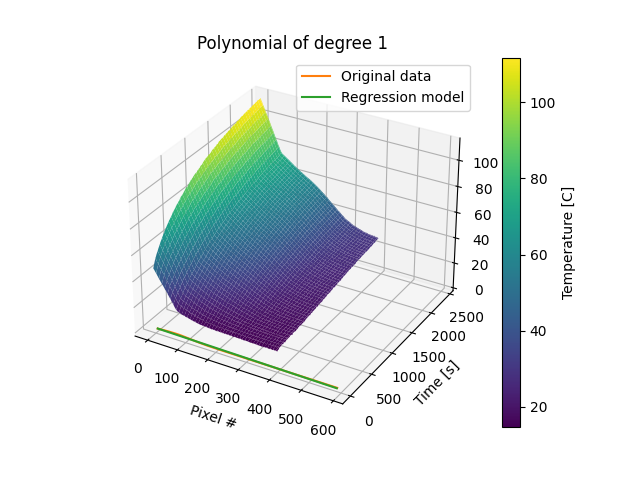

Regression formula = 21.957410562180574 - 17.073491986232312·x¹


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
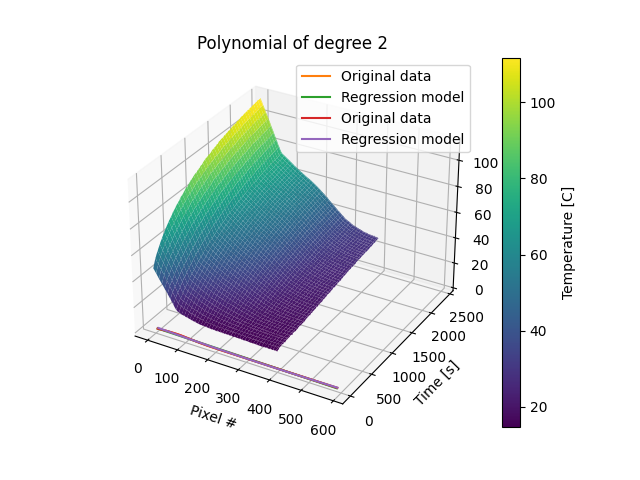

Regression formula = 14.88943657349756 - 17.073491986232316·x¹ + 21.131799782491036·x²


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
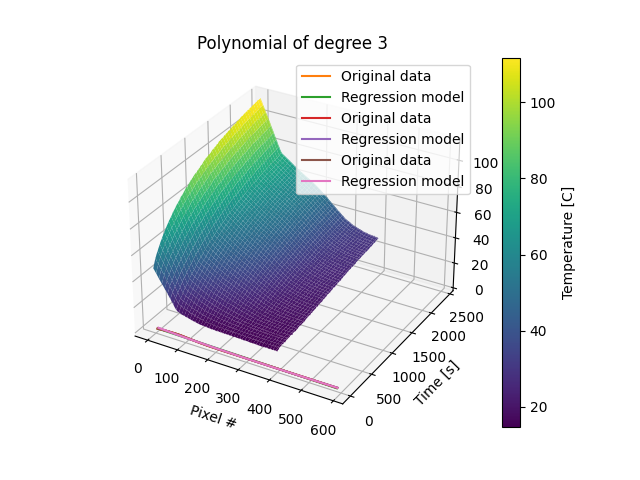

Regression formula = 14.889436573497553 - 12.31977101791055·x¹ + 21.131799782491047·x² -
7.895950302978702·x³


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
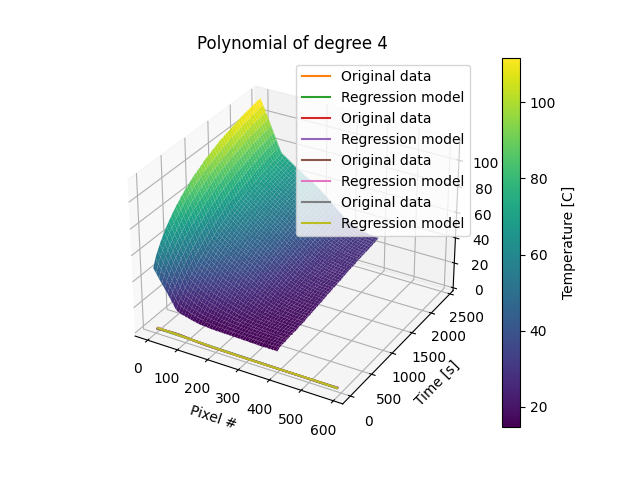

Regression formula = 12.550488328348953 - 12.319771017910547·x¹ + 44.44204187720857·x² -
7.895950302978691·x³ - 27.103043676611957·x⁴


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
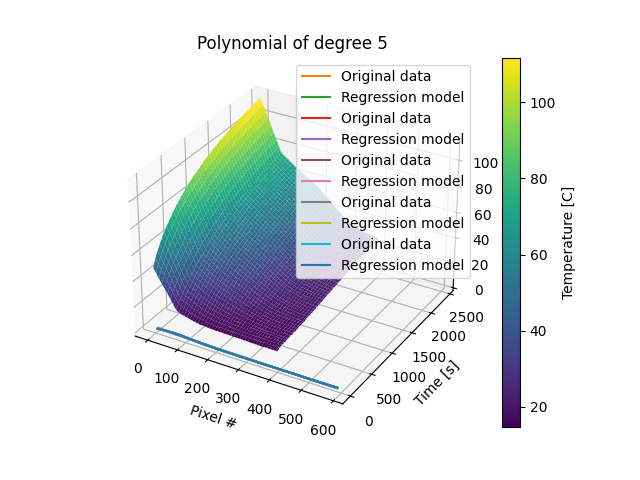

Regression formula = 12.550488328348953 + 6.249301947461472·x¹ + 44.44204187720863·x² -
94.25871500594994·x³ - 27.10304367661202·x⁴ + 77.46346130202213·x⁵


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
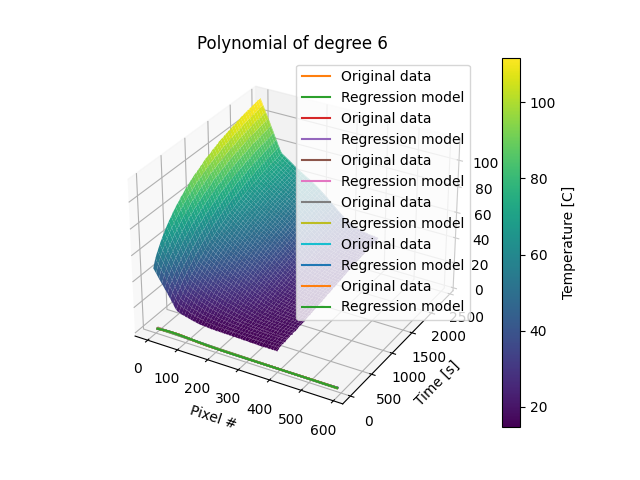

Regression formula = 14.737293291500198 + 6.2493019474614515·x¹ - 1.3262559669119294·x² -
94.25871500594984·x³ + 109.73906264295105·x⁴ + 77.46346130202201·x⁵ -
100.01225748858226·x⁶


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
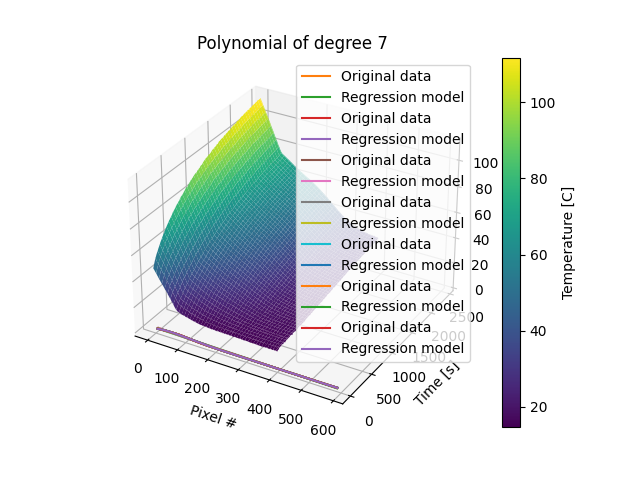

Regression formula = 14.737293291500208 + 3.196994162195612·x¹ - 1.326255966911958·x² -
66.8801115725557·x³ + 109.73906264295096·x⁴ + 17.43285238191869·x⁵ -
100.01225748858212·x⁶ + 37.03683799287383·x⁷


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
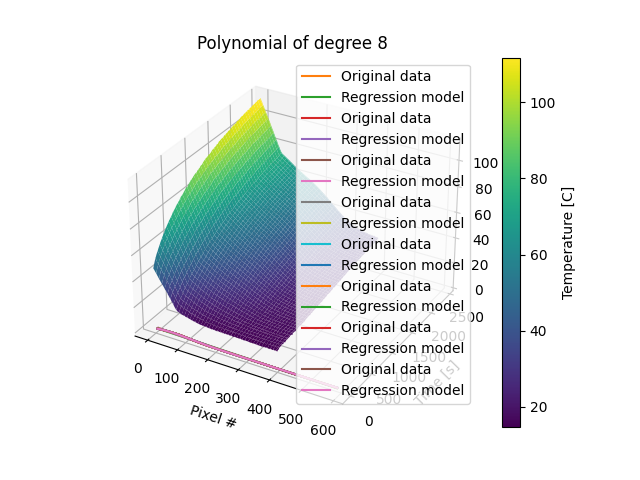

Regression formula = 15.391525617261989 + 3.196994162195541·x¹ - 24.80000842704009·x² -
66.88011157255538·x³ + 238.41328428660802·x⁴ + 17.432852381917986·x⁵ -
322.3014241242754·x⁶ + 37.0368379928742·x⁷ + 118.68463627406933·x⁸


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
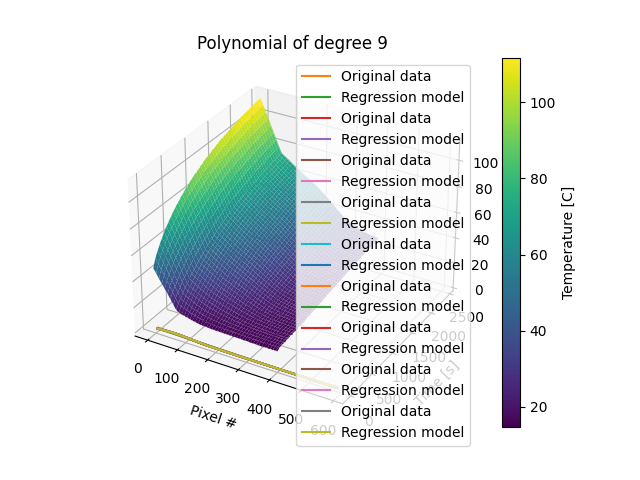

Regression formula = 15.391525617261951 - 4.218395206870691·x¹ - 24.800008427039284·x² +
41.51760299274111·x³ + 238.41328428660591·x⁴ - 403.9121001014847·x⁵ -
322.3014241242743·x⁶ + 636.9537944606382·x⁷ + 118.68463627406987·x⁸ -
282.3496529489218·x⁹


In [26]:
for deg in range(1,10):
    steel_ss_silicone.polyreg(steel_ss_silicone.data.index, steel_ss_silicone.data[0], deg)

Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
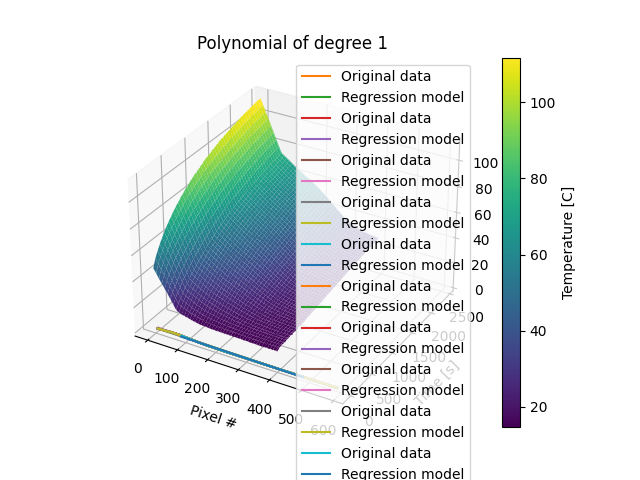

Regression formula = 18.871321695760585 - 10.729381769456955·x¹
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
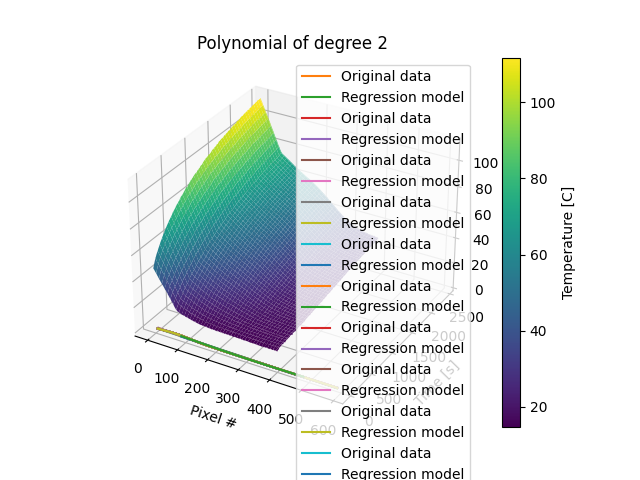

Regression formula = 13.599666950461861 - 10.729381769456962·x¹ + 15.736282821787253·x²
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
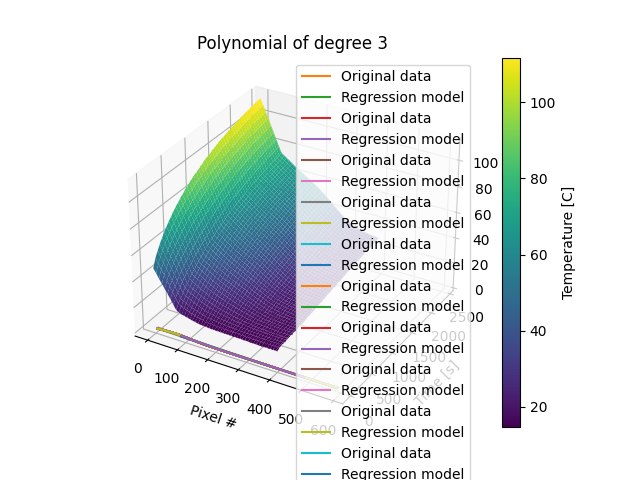

Regression formula = 13.599666950461861 + 0.1731123128592009·x¹ + 15.736282821787237·x² -
18.080571285526677·x³
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
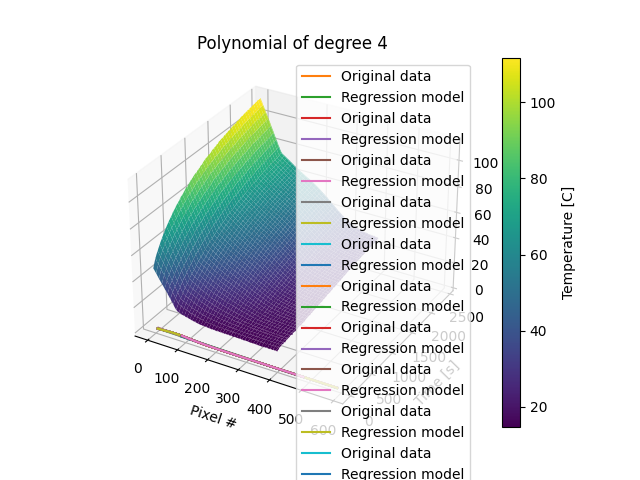

Regression formula = 14.819071095827395 + 0.17311231285921316·x¹ + 3.6025560940711276·x² -
18.080571285526673·x³ + 14.085878578579653·x⁴
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
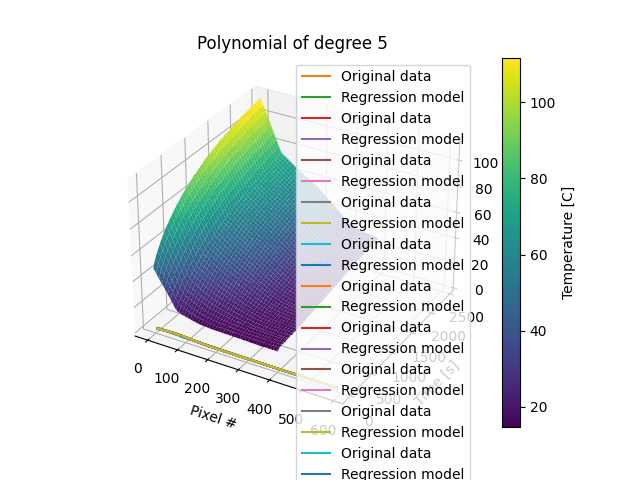

Regression formula = 14.819071095827384 + 0.0019392426339045242·x¹ + 3.6025560940711276·x² -
17.28570154070549·x³ + 14.085878578579642·x⁴ - 0.7118502136538182·x⁵
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
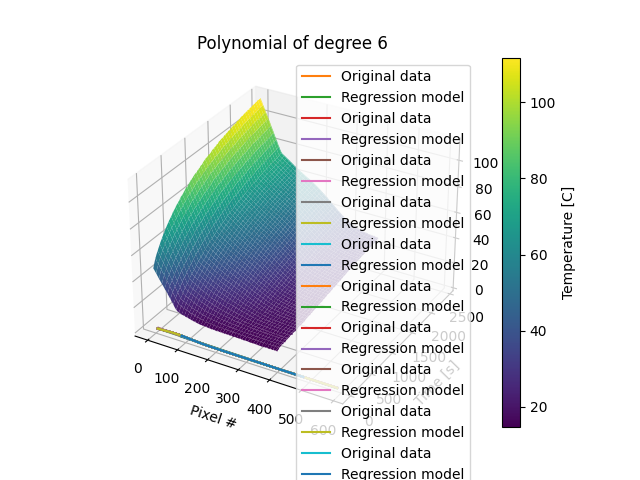

Regression formula = 15.188936249629418 + 0.0019392426339425333·x¹ - 4.126546334193073·x² -
17.28570154070549·x³ + 37.159356753485156·x⁴ - 0.7118502136537511·x⁵ -
16.837346109572447·x⁶
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
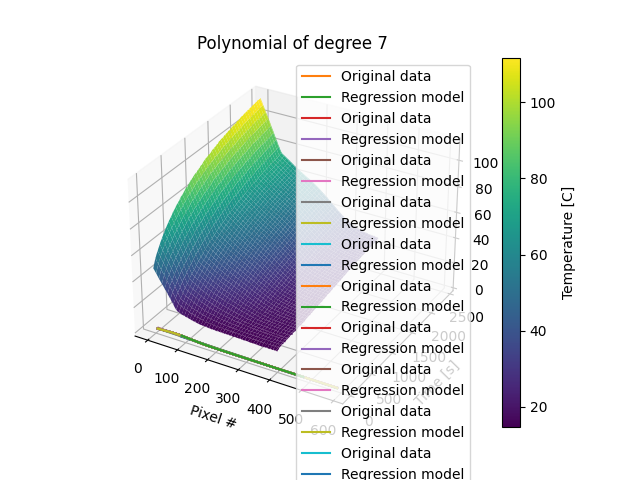

Regression formula = 15.188936249629409 - 3.05998722186113·x¹ - 4.126546334193111·x² +
10.137264269879521·x³ + 37.15935675348507·x⁴ - 60.74769924290437·x⁵ -
16.83734610957256·x⁶ + 36.98321525737774·x⁷
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
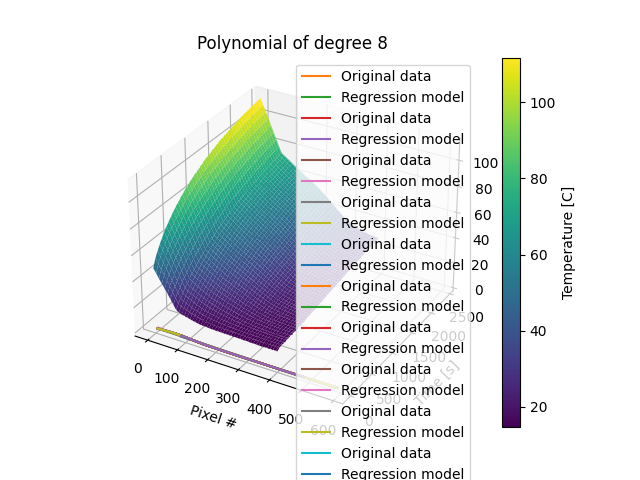

Regression formula = 14.920313514440481 - 3.0599872218611197·x¹ + 5.497077375354661·x² +
10.137264269879566·x³ - 15.51401093188814·x⁴ - 60.74769924290449·x⁵ +
74.01985093735367·x⁶ + 36.98321525737785·x⁷ - 48.436763735240206·x⁸
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}
Using meta parameters {'start_pix': 80, 'end_pix': 480, 'pix_spacing': 1, 'start_t': 0, 'end_t': 2410, 't_interval': 5}


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
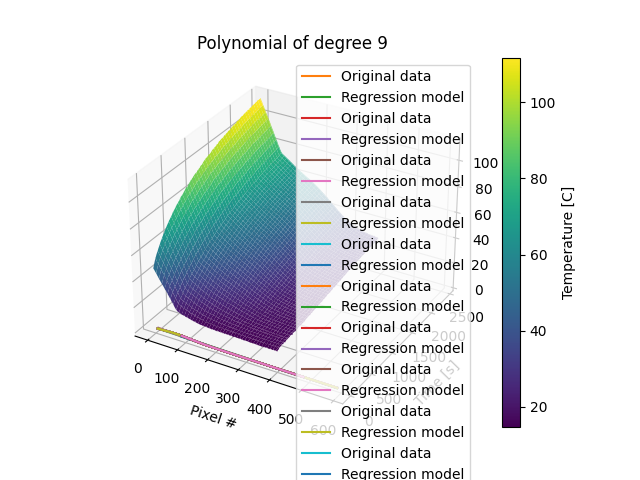

Regression formula = 14.920313514440473 - 3.2545821187848696·x¹ + 5.497077375354572·x² +
12.977606322313331·x³ - 15.514010931887348·x⁴ - 71.77170476581874·x⁵ +
74.01985093735182·x⁶ + 52.655847726070384·x⁷ - 48.4367637352391·x⁸ -
7.365213359256753·x⁹


In [27]:
for deg in range(1,10):
    steel_ss_silicone.polyreg(steel_ss_silicone.reduce_data(pix_spacing=1).index, steel_ss_silicone.reduce_data(pix_spacing=1)[0], deg)

In [28]:
data = steel_ss_silicone.data
X_ = data.to_numpy()

x = data.index.to_numpy()
t = data.columns.to_numpy()

xgrid, tgrid = np.meshgrid(x, t)

plt.pcolor(xgrid, tgrid, X_)

TypeError: Dimensions of C (587, 483) are incompatible with X (587) and/or Y (483); see help(pcolor)

In [ ]:


X1 = f1(xgrid, tgrid)
X2 = f2(xgrid, tgrid)
X = X1 + X2

titles = ['$f_1(x,t)$', '$f_2(x,t)$', '$f$']
data = [X1, X2, X]

fig = plt.figure(figsize=(17, 6))
for n, title, d in zip(range(131, 134), titles, data):
    plt.subplot(n)
    plt.pcolor(xgrid, tgrid, d.real)
    plt.title(title)
plt.colorbar()
plt.show()

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection="3d", title=f"Surface plot of {title.lower()}'s data", xlabel="Pixel #", ylabel="Time [s]", zlabel="Temperature [C]")
X, Y = np.meshgrid(data.index, data.columns)
ax.plot_surface(X, Y, data.to_numpy().T, cmap="viridis")
ys = np.arange(0, data.columns.max(), 5)
zs = np.linspace(0, data.max(), np.shape(ys)[0])
yy, zz = np.meshgrid(ys, zs)
xx1 = 100
xx2 = 500
ax.plot_surface(xx1, yy, zz)
ax.plot_surface(xx2, yy, zz)
fig.show()

In [ ]:
start_pix = 100
end_pix = 500
pix_spacing = 5
start_t = 0
stop_t = 2400
timestep = 5
#data.loc[start_pix:end_pix:10][0:2000:5]

data.loc[start_pix:end_pix:pix_spacing, range(start_t, stop_t+1, int(timestep))]

In [ ]:
tscv = TimeSeriesSplit()
for train_index, test_index in tscv.split(X):
    print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

In [ ]:
X_train.shape

In [ ]:
X_test.shape

In [ ]:
plt.title('Original')
plt.imshow(X, origin='lower')
plt.axis('off')
plt.colorbar(label='Temperature [$ \degree C$]')
plt.show()

U, S, VT = np.linalg.svd(X,full_matrices=False)
S = np.diag(S)

j = 0
for r in (2, 5, 20, 100):
    # Construct approximate image
    Xapprox = U[:,:r] @ S[0:r,:r] @ VT[:r,:]
    err = Xapprox - X
    fig, (ax1, ax2) = plt.subplots(1,2)
    #plt.figure(j+1)
    j += 1
    ax1.imshow(Xapprox, origin='lower')
    ax2.imshow(err, origin='lower')
    #img.set_cmap('')
    #plt.axis('on')
    #plt.xlabel('Time [$s$]')
    #plt.ylabel('Pixel')
    #fig.colorbar(cmap=cmap, label='temperature')
    #fig.colorbar(mappable=[0,120], ax=ax2)


    #plt.colorbar(label='Temperature [$ \degree C$]')
    plt.title('r = ' + str(r))
    plt.show()
    #print(f'r = {r} and U = {VT[:r,:]}')

In [ ]:
def grad_pix_over_time(pixels):
    for pix in pixels:
        plt.plot(df.loc[pix][:].diff(), label=pix)
    plt.xlabel('Time [$s$]')
    plt.ylabel('Temperature gradient $\\frac{dT}{dt}$ [$ \\frac{\degree C}{s}$]')
    plt.legend(title='Pixel #')
    plt.show()
#grad_pix_over_time(pixels)

In [ ]:
SVD = TruncatedSVD(n_components=5,
    algorithm='randomized',
    n_iter=5,
    random_state=42, # Choose a state for repeatable results
    )
model = SVD.fit(df)

#### References:
Finding structure with randomness: Stochastic algorithms for constructing
approximate matrix decompositions
Halko, et al., 2009 (arXiv:909) https://arxiv.org/pdf/0909.4061.pdf

#### Notes:
SVD suffers from a problem called "sign indeterminacy", which means the
sign of the ``components_`` and the output from transform depend on the
algorithm and random state. To work around this, fit instances of this
class to data once, then keep the instance around to do transformations.